# 1. <a id='toc1_'></a>[Spatial Analysis: Suitability Model](#toc0_)

## 1.1. <a id='toc1_1_'></a>[Credits](#toc0_)

**Instructor**: Rod Sardari, PhD, GISP  
rsardari@utdallas.edu  
**Teaching Assistant**: Yalin Yang  
yalin.yang@utdallas.edu


**Table of contents**<a id='toc0_'></a>

1. [Spatial Analysis: Suitability Model](#toc1_)  
   1.1. [Credits](#toc1_1_)
2. [Introduction](#toc2_)  
   2.1. [Define Objectives](#toc2_1_)  
   2.2. [Measurable Criteria](#toc2_2_)  
   2.3. [Selected Variables:](#toc2_3_)
3. [Data Prepare](#toc3_)  
   3.1. [Get CDC Census Tract Data](#toc3_1_)  
   3.2. [Get GIS Census 2010 Tract Layer](#toc3_2_)  
   3.3. [Get Transit Stations Data](#toc3_3_)  
   3.3.1. [Get Dallas Transportation Authority GTFS](#toc3_3_1_)  
   3.3.2. [Get Fort Worth Transportation Authority GTFS](#toc3_3_2_)  
   3.3.3. [Get Denton County Transportation Authority GTFS](#toc3_3_3_)  
   3.3.4. [Use Tableau Prep to Create a Union from GTFS data](#toc3_3_4_)  
   3.3.5. [Geocoding GTFS Stops](#toc3_3_5_)  
   3.4. [Get Longitudinal Employer-Household Dynamics (LEHD) data](#toc3_4_)  
   3.4.1. [Longitudinal Employer-Household Dynamics (LEHD) Data](#toc3_4_1_)  
   3.4.2. [Data Download](#toc3_4_2_)  
   3.5. [Get Hospital GIS Data](#toc3_5_)
4. [Network Analysis](#toc4_)  
   4.1. [Service Area Buffers using Network Analysis](#toc4_1_)  
   4.2. [Spatial Join Analysis](#toc4_2_)  
   4.3. [Create a Choropleth map to verify spatial joins](#toc4_3_)  
   4.4. [Suitability Analysis using Business Analysis](#toc4_4_)  
   4.4.1. [Add Fields from ArcGIS Online Data Browser](#toc4_4_1_)  
   4.4.2. [Apply Weights to Suitability Model](#toc4_4_2_)
5. [Additional Sources](#toc5_)

<!-- vscode-jupyter-toc-config
	numbering=true
	anchor=true
	flat=true
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->


# 2. <a id='toc2_'></a>[Introduction](#toc0_)

- This exercise guide is designed to help you develop a `suitability model` for establishing `hospital charity care centers` and finding the best locations within the `Dallas Fort Worth` Area.
  - `Hospital charity care` refers to healthcare services hospitals provide to **individuals who cannot pay for medical treatment** due to financial hardship.
  - These individuals often lack health insurance coverage and cannot afford the cost of their medical care.
  - Hospital charity care is a way for healthcare institutions to fulfill their social responsibility and provide essential medical services to those in need.

## 2.1. <a id='toc2_1_'></a>[Define Objectives](#toc0_)

The main objective of this exercise is to find the **best location** for establishing `hospital charity care centers` that can provide better services to the target population within the Dallas Fort Worth Area, including:

- Dallas County
- Collin County
- Denton County
- Tarrant County

## 2.2. <a id='toc2_2_'></a>[Measurable Criteria](#toc0_)

Selecting the right location is crucial for optimizing the allocation of resources and ensuring accessibility to those in need. In this step, we need to gather relevant data, including:

- `Demographic data` (e.g., population density, income levels).
- `Healthcare facilities` (existing hospitals, clinics, etc.).
- `Accessibility factors` (e.g., transit infrastructure).
- `Social and economic indicators` (e.g., unemployment rates, poverty levels).

## 2.3. <a id='toc2_3_'></a>[Selected Variables:](#toc0_)

In this exercise, these variables are selected to create the suitability model:

- CDC Health Outcomes
- Stroke among adults
- Cancer (excluding skin cancer) among adults
- Coronary heart disease among adults
- Transportation and Public Transit
- Access to Public Transit Stations
- Economic indicators
- Percentage of Low Wage Workers


# 3. <a id='toc3_'></a>[Data Prepare](#toc0_)

## 3.1. <a id='toc3_1_'></a>[Get CDC Census Tract Data](#toc0_)


1. Download [CDC Health Data](https://data.cdc.gov/500-Cities-Places/PLACES-Census-Tract-Data-GIS-Friendly-Format-2023-/yjkw-uj5s)

   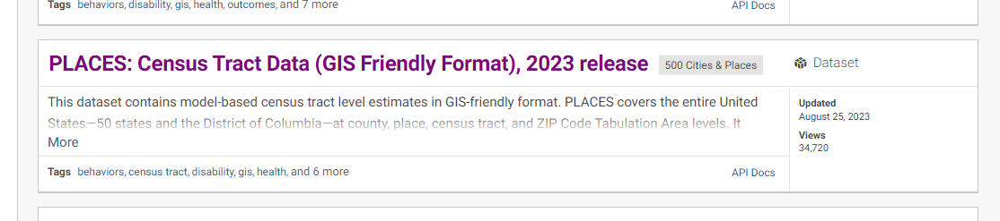

2. Data for the DFW area is extracted and exported to the GIS geodatabase file.

   - DFW_Health_Out_CT_tab

   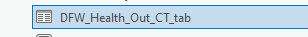
   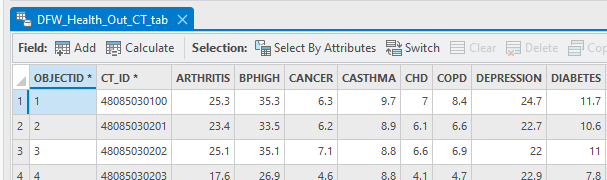


## 3.2. <a id='toc3_2_'></a>[Get GIS Census 2010 Tract Layer](#toc0_)


- The CDC data is based on the 2010 Census Tract GIS layer.
- You need to download the Census Tract 2010 GIS Layer and join the CDC table to the GIS Census Tract layer.

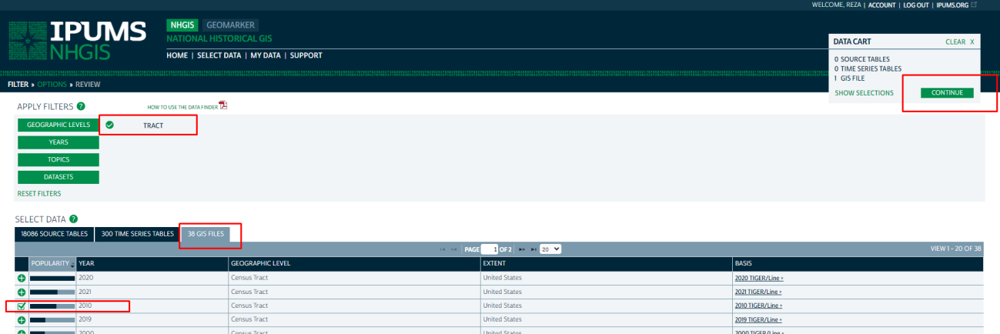

1. Download and Import the unzipped Shapefile to the geodatabase

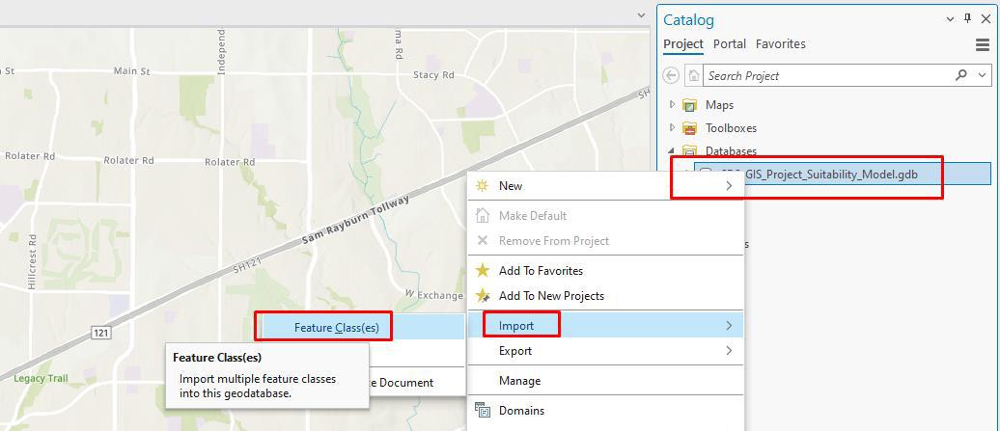

2. Import the GIS Census Tract layer to the geodatabase

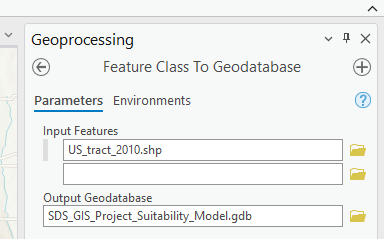

3. Add `US_tract_2010` layer and `DFW_Health_Out_CT_tab` table

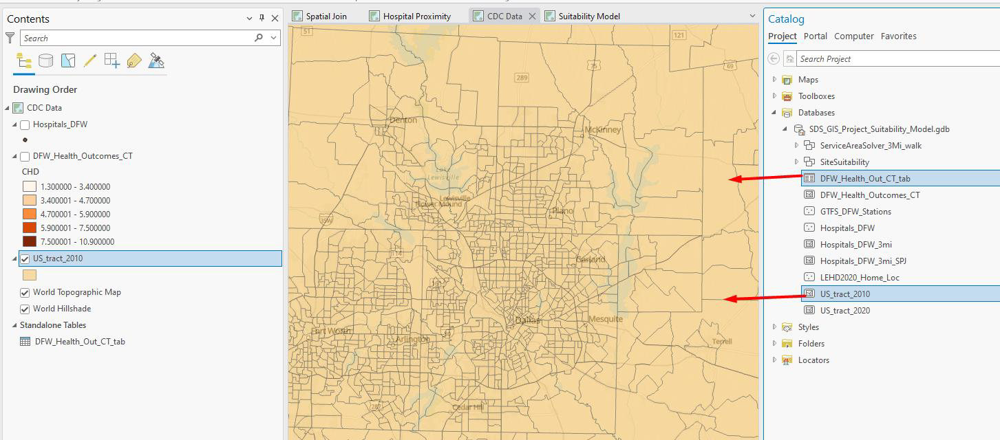

4. Inside `CDC Health data table`, Check the data type format for `CT_ID`

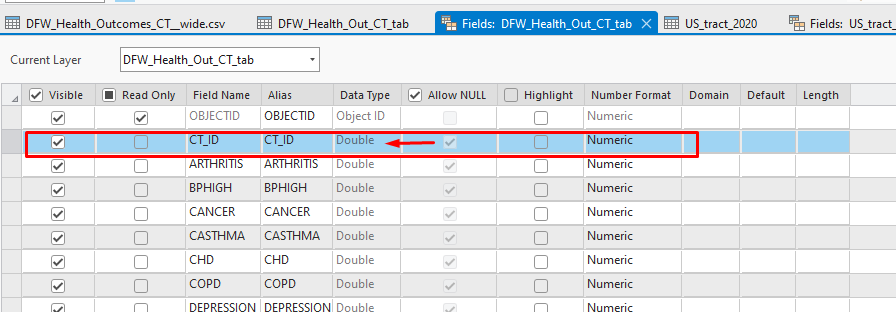

5. Open the Census Tract layer `US_tract_2010`, and check the data type format for `GEOID10`

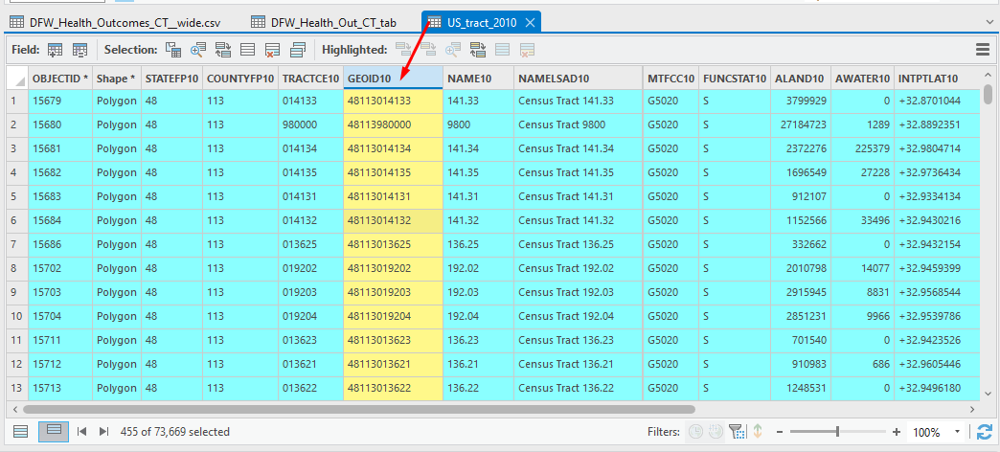

6. Transform `GEOID10` to a number format

   - `GEOID10`: Data Type: Text

     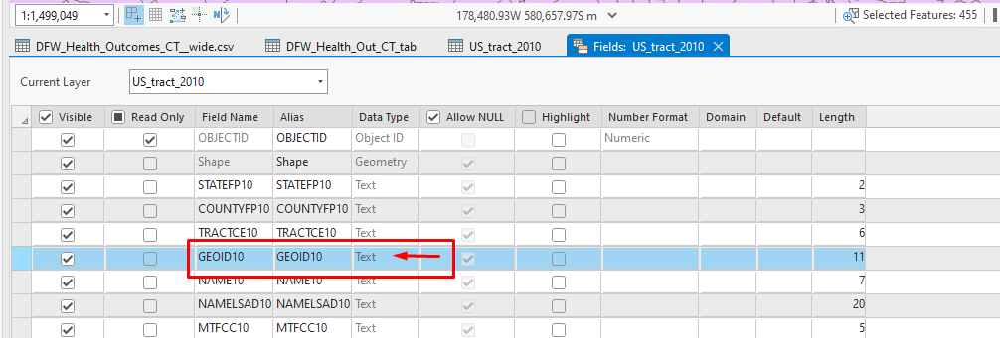

   - Add a new column and copy GEOID as a number format.

     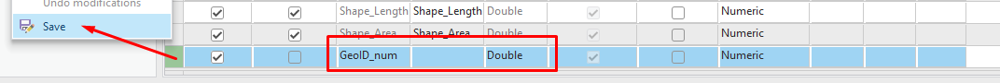

   - Save

     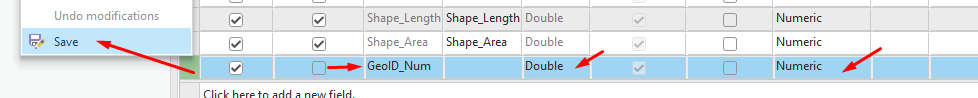

   - Use `Calculate Field` and copy records from `GEOID10` to `GEOID_Num`

     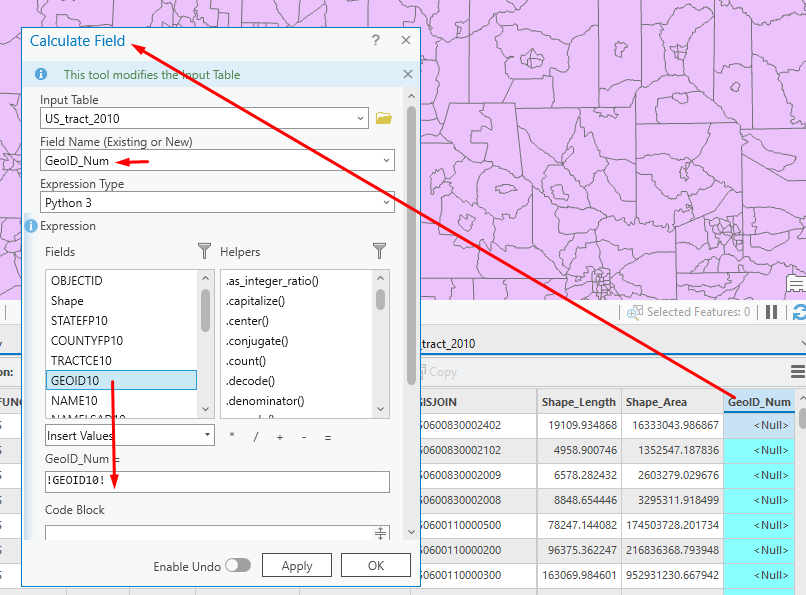

7. Use the `Add Join` tool to join CDC data to the GIS layer  
   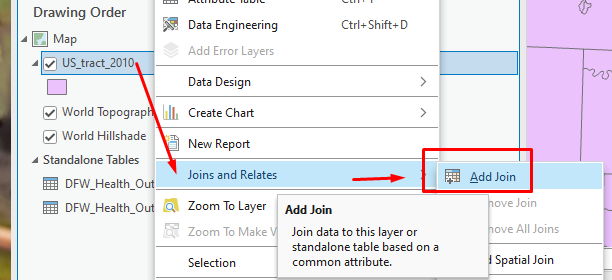
   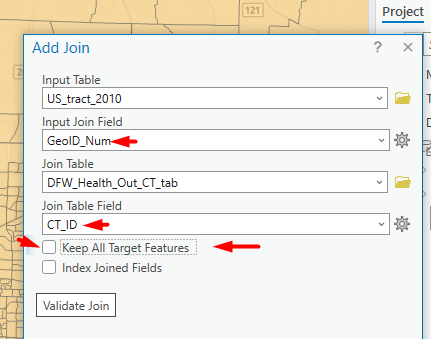

- The result of data join is available for the DFW area, and unmatched records are removed.

  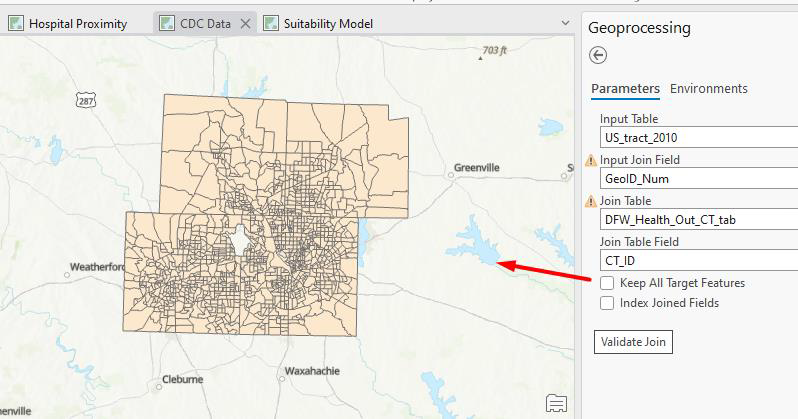


8. Export the results of `data joins`

   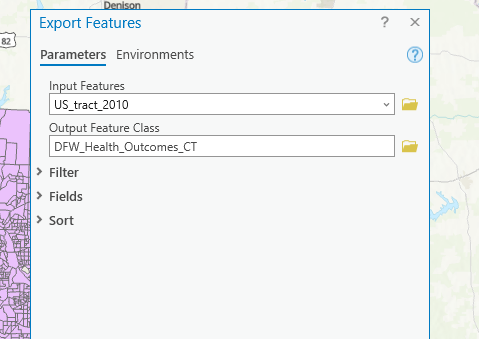

9. Explore the distribution of `Health Outcomes` by changing symbology and using `Graduated Colors`

   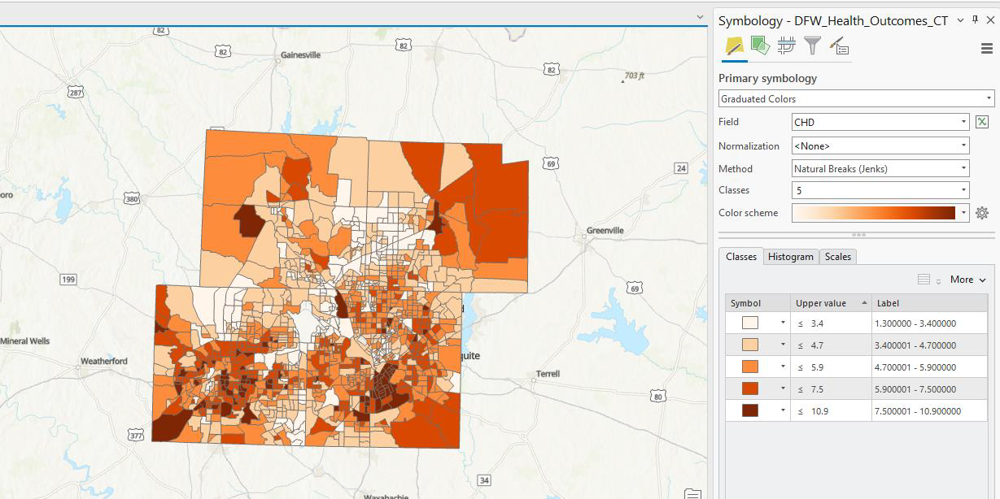


## 3.3. <a id='toc3_3_'></a>[Get Transit Stations Data](#toc0_)

1. `GTFS` stands for `General Transit Feed Specification`, a standardized format for public transportation schedules and geographic information.
2. `GTFS` data is used by transit agencies, app developers, and other organizations to provide information about public transit systems, including buses, trains, trams, subways, and ferries.

<table>
  <tr>
    <th>GTFS Component</th>
    <th>Description</th>
    <th>File Structure</th>
  </tr>
  <tr>
    <td><strong>Agency Information</strong></td>
    <td>General information about the transit agency or organization responsible for providing the service, including agency name, website, and contact information.</td>
    <td rowspan="8"><img src="./demo.jpg" alt="File Structure"></td>
  </tr>
  <tr>
    <td><strong>Calendar Dates</strong></td>
    <td>Information about service availability on specific dates, such as holidays or exceptions to regular schedules.</td>
  </tr>
  <tr>
    <td><strong>Routes</strong></td>
    <td>Details about transit routes, including route names, unique identifiers, and descriptions.</td>
  </tr>
  <tr>
    <td><strong>Shapes</strong></td>
    <td>Geometric data that defines the physical paths followed by transit vehicles along their routes. Shapes data is often used to display routes on maps.</td>
  </tr>
  <tr>
    <td><strong>Stop Times</strong></td>
    <td>When vehicles (e.g., buses or trains) arrive and depart from each stop for each trip. This data includes arrival and departure times and stop sequence information.</td>
  </tr>
  <tr>
    <td><strong>Stops</strong></td>
    <td>Information about transit stops, including their names, unique identifiers, and geographic coordinates (latitude and longitude).</td>
  </tr>
  <tr>
    <td><strong>Trips</strong></td>
    <td>Information about specific trips along transit routes, including trip IDs, service IDs, and the order of stops for each trip.</td>
  </tr>
</table>


- GTFS data is provided as a collection of Text (`.txt`) and `CSV` (Comma-Separated Values) files, which makes it easy to read and process using various software tools and programming languages.
  - **Public transit agencies**, especially in urban areas, often publish their transit schedules and information in `GTFS` format.
- Developers use `GTFS` data to create transit-related applications and services, such as journey planners, real-time transit tracking apps, and route optimization tools.
  - It allows users to access accurate and **up-to-date information about public transportation systems**, making planning trips and navigating urban areas easier.


### 3.3.1. <a id='toc3_3_1_'></a>[Get Dallas Transportation Authority GTFS](#toc0_)


1. Go to [Transit Feeds website](https://transitfeeds.com/)

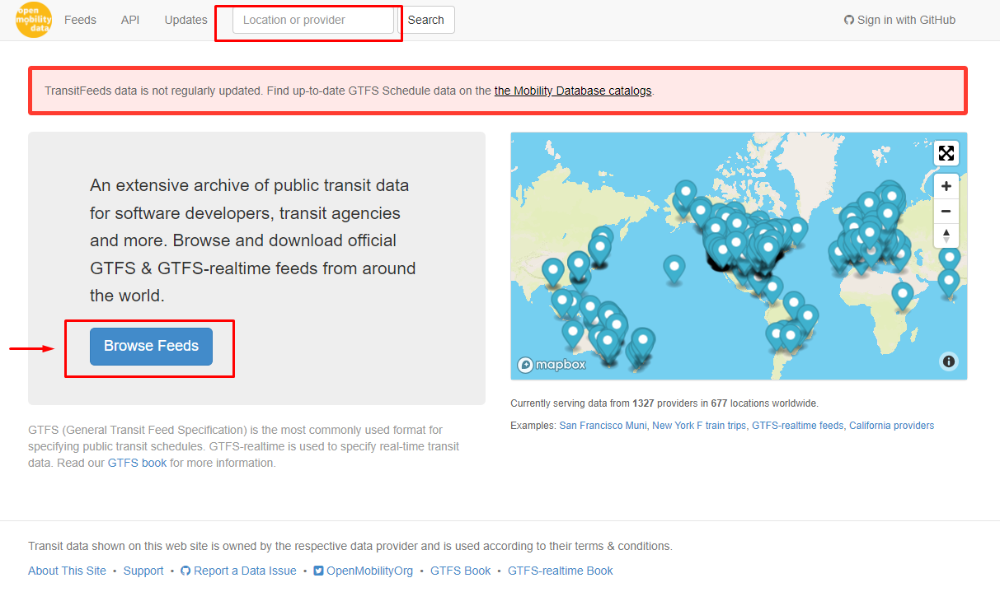

2. Search for a transit agency

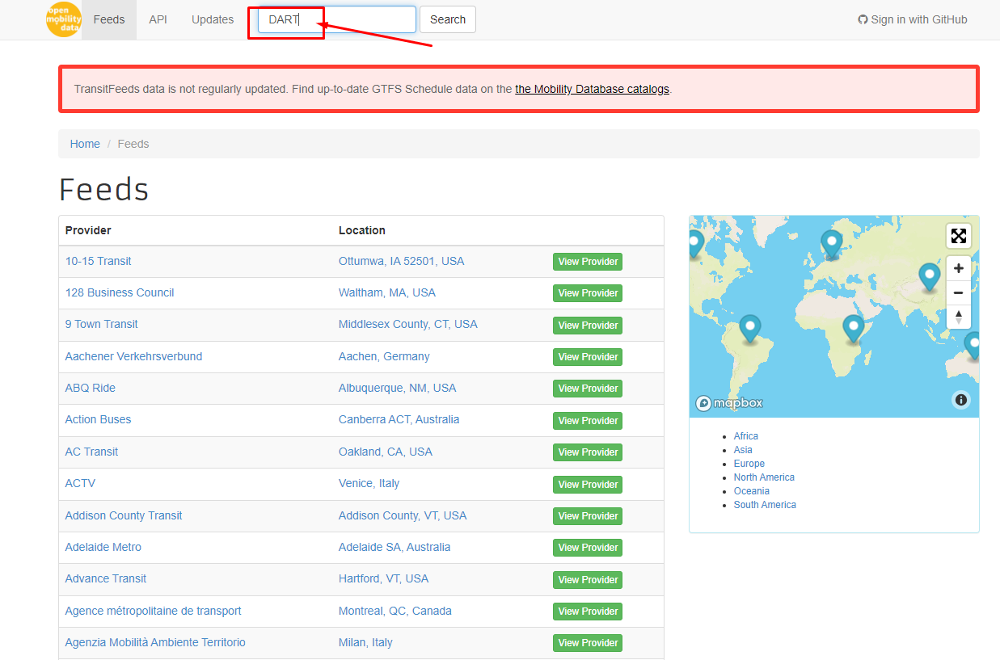
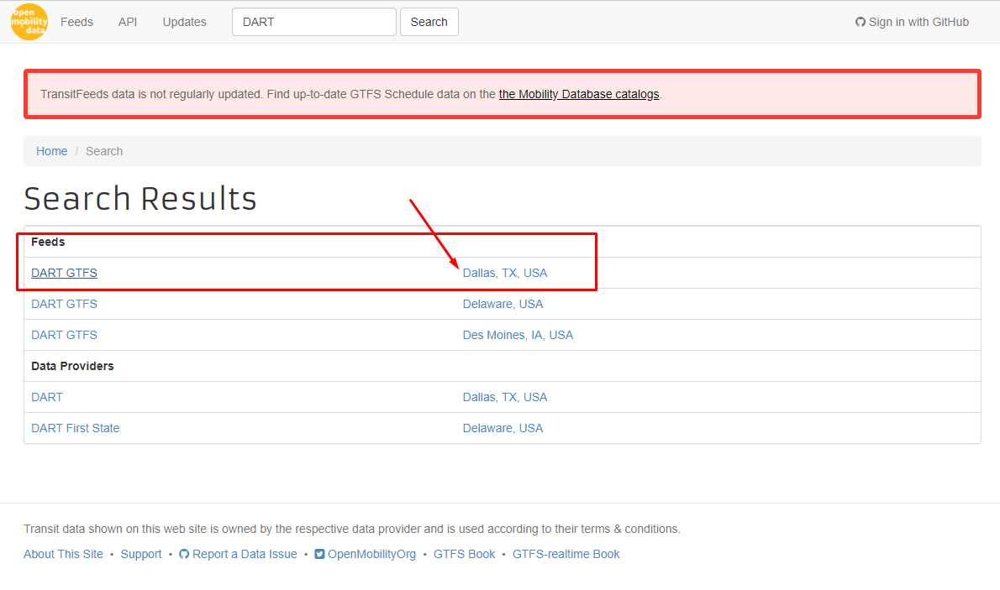

3. Select and download GTFS data

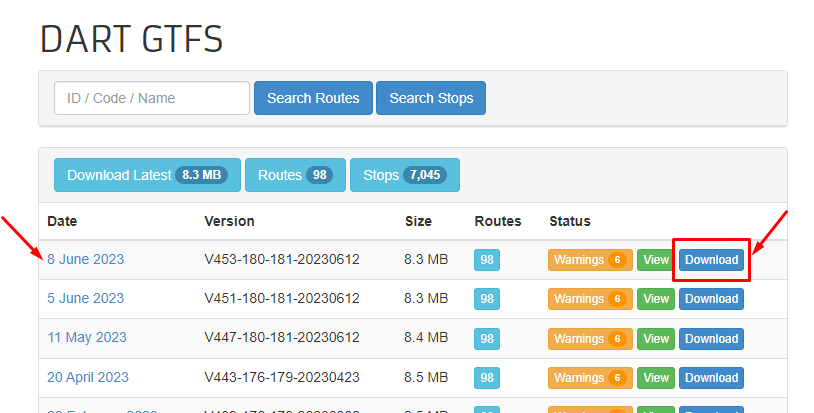
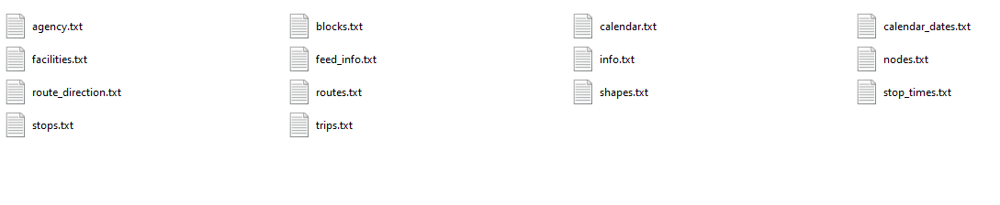

- Review the `stops.txt` file

  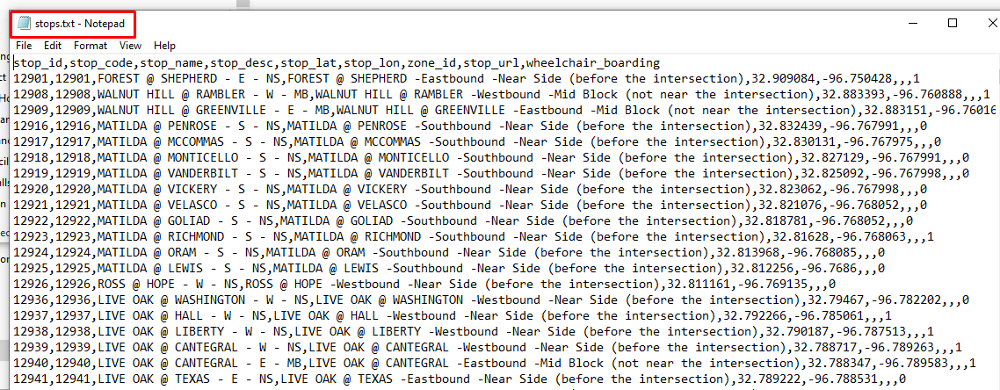

- Review the `stop_times.txt` file

  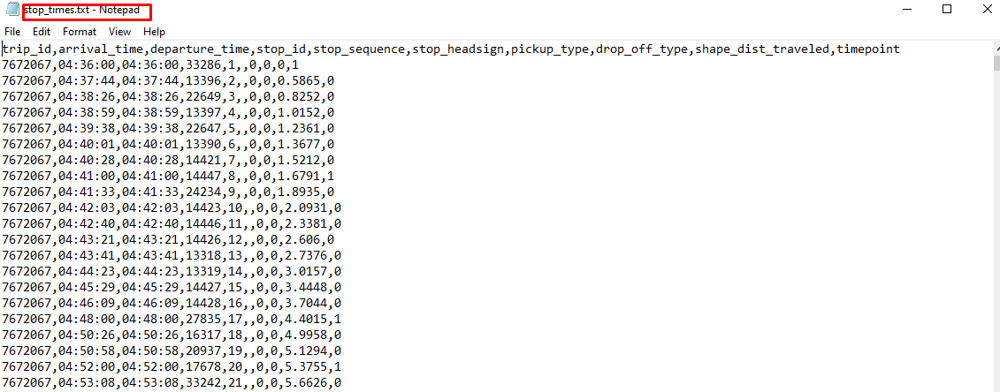

- Review the `calendar.txt` file

  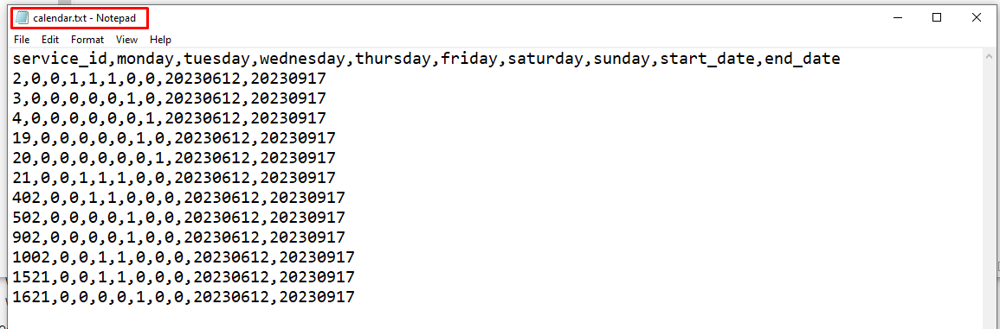


### 3.3.2. <a id='toc3_3_2_'></a>[Get Fort Worth Transportation Authority GTFS](#toc0_)


1. Download the `FWTA` GTFS file (Fort Worth Transportation Authority)

   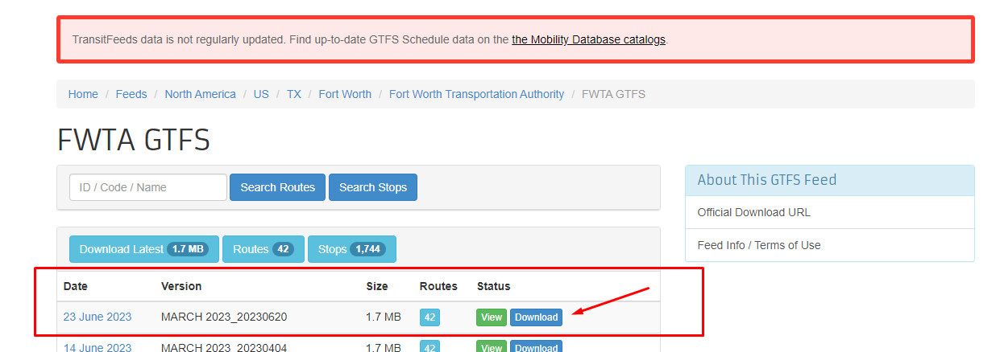


### 3.3.3. <a id='toc3_3_3_'></a>[Get Denton County Transportation Authority GTFS](#toc0_)


1. Download the `DCTA` GTFS file (Denton County Transportation Authority)

   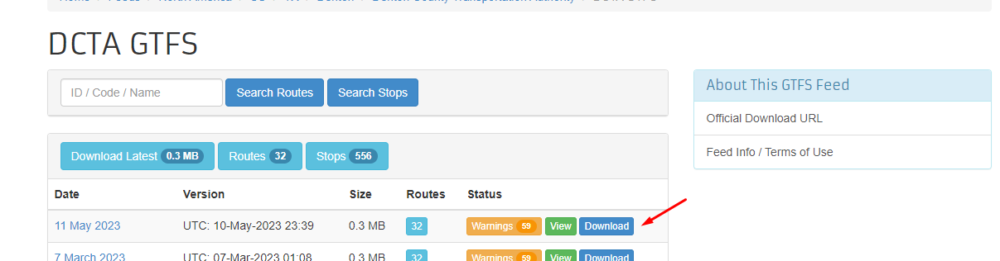


### 3.3.4. <a id='toc3_3_4_'></a>[Use Tableau Prep to Create a Union from GTFS data](#toc0_)


1. Import all GTFS data from different transist agency and create a union file

   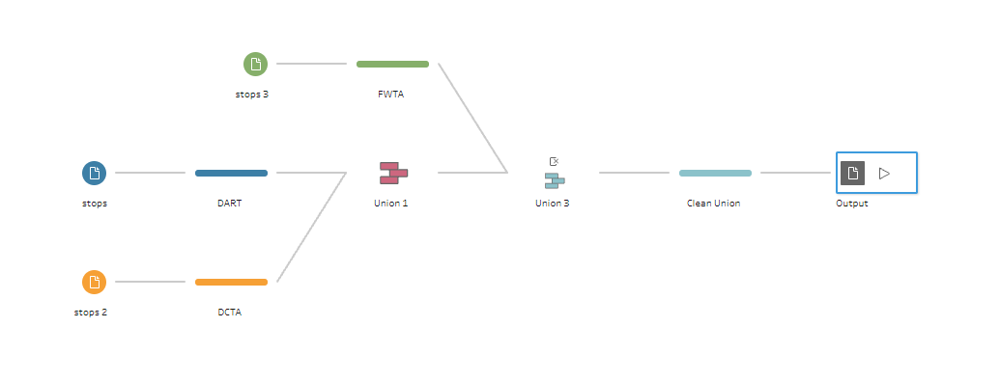
   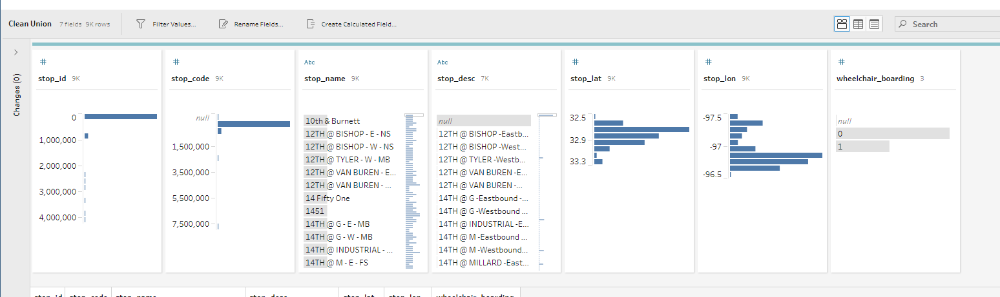


### 3.3.5. <a id='toc3_3_5_'></a>[Geocoding GTFS Stops](#toc0_)


1. Geocoding DFW GTFS data in ArcGIS using the `Display XY Data` tool

   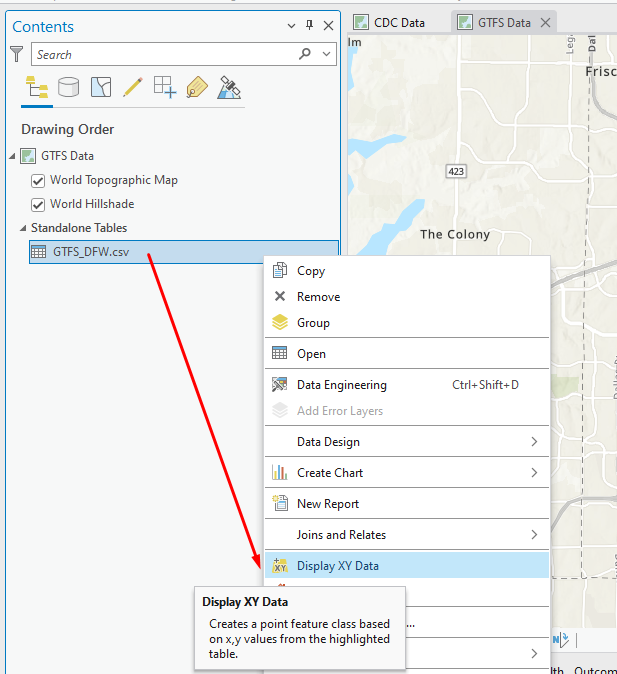
   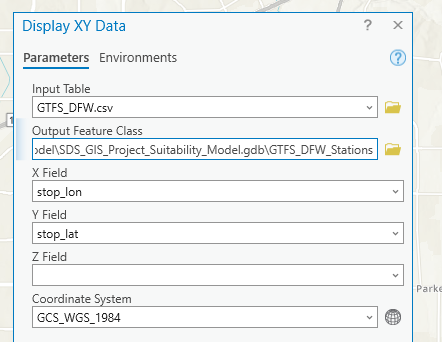

2. Review Stops location in ArcGIS

   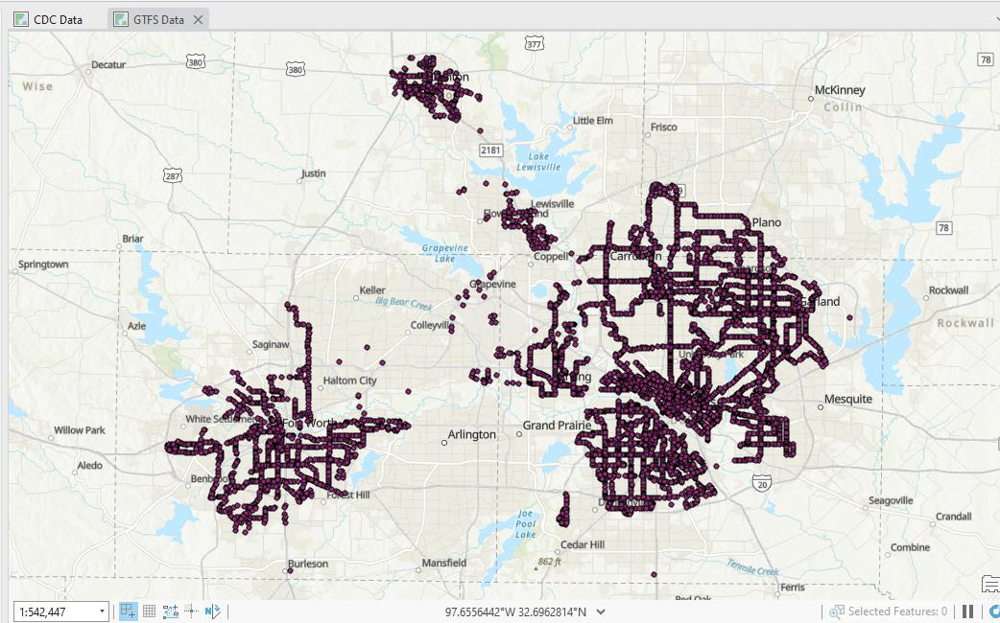


## 3.4. <a id='toc3_4_'></a>[Get Longitudinal Employer-Household Dynamics (LEHD) data](#toc0_)

- The `Longitudinal Employer-Household Dynamics (LEHD)` data and `OnTheMap` are programs and tools provided by the United States Census Bureau to facilitate research and analysis related to employment, labor markets, and commuting patterns.
- They are valuable resources for economists, policymakers, businesses, and researchers interested in understanding the dynamics of the U.S. labor market. Here’s an overview of each:

### 3.4.1. <a id='toc3_4_1_'></a>[Longitudinal Employer-Household Dynamics (LEHD) Data](#toc0_)

- `LEHD` is a program that collects, maintains, and provides access to various administrative data sources related to employment and commuting. It includes data from state `unemployment insurance (UI)` programs, the `Quarterly Census of Employment and Wages (QCEW)`, and other sources. The main components of LEHD data are listed below:

1. **Quarterly Workforce Indicators (QWI)**: These provide detailed, quarterly data on employment, job creation and destruction, earnings, and other labor market measures at various geographic levels (e.g., states, counties, and metro areas).
2. **LEHD Origin-Destination Employment Statistics (LODES)**: LODES data offer information about workers’ employment and commuting patterns. It allows researchers to analyze where workers live and work, which is valuable for understanding regional labor markets.
3. **Job-to-Job Flows (J2J)**: J2J data provide insights into job changes and worker transitions in the labor market. It tracks movements between jobs and includes information on hiring, separations, and more.
4. **OnTheMap**: OnTheMap is a web-based tool and application that allows users to explore LEHD data interactively. It provides access to various reports and mapping features, enabling users to visualize employment and commuting patterns, view regional labor market dynamics, and conduct in-depth research.

### 3.4.2. <a id='toc3_4_2_'></a>[Data Download](#toc0_)


1. Go to OnTheMap: [https://onthemap.ces.census.gov/](https://onthemap.ces.census.gov/)
2. Search: Dallas (Metropolitan Area)

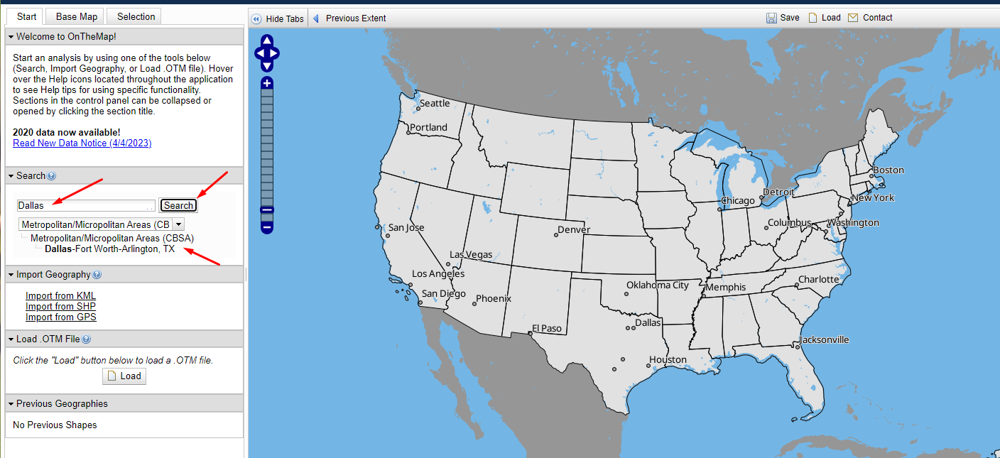


3. Perform Analysis on the Selection Area
   `LEHD` Analysis Settings

- `Home/Work Area`: Select `Home`
- Analysis Type: `Area Profile` – `All Workers`
- Year: 2020
- Job Type: `All Jobs`

  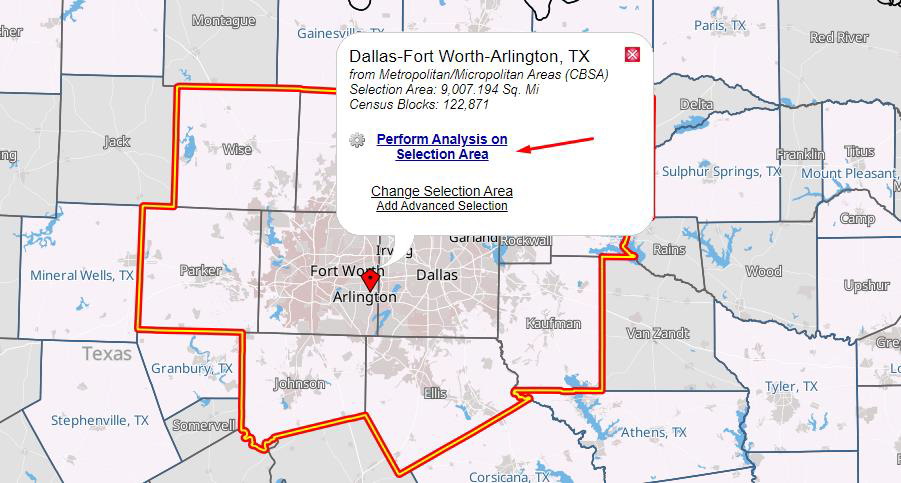
  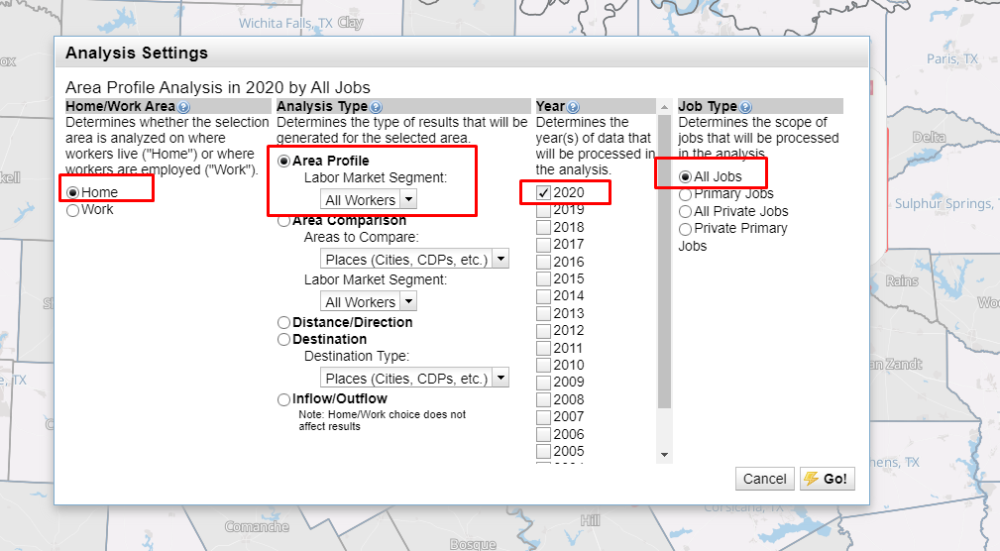

4. Export Geographics

- Choose the `ShapeFile` format
  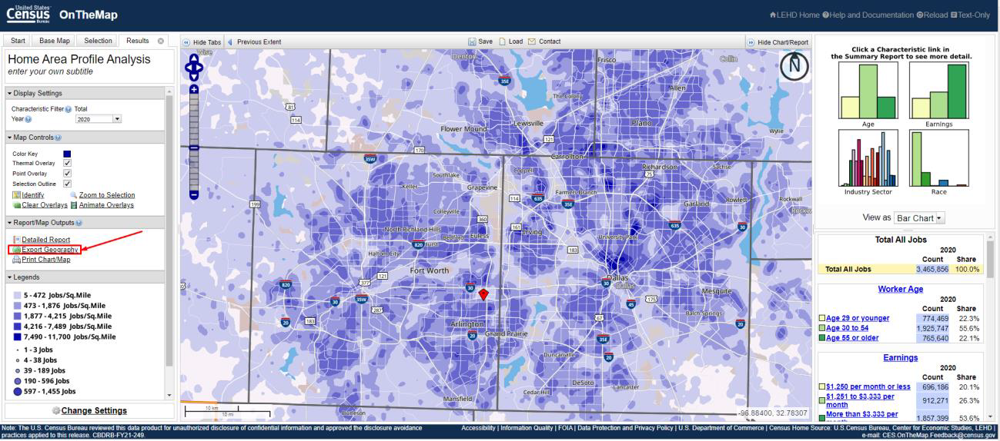
  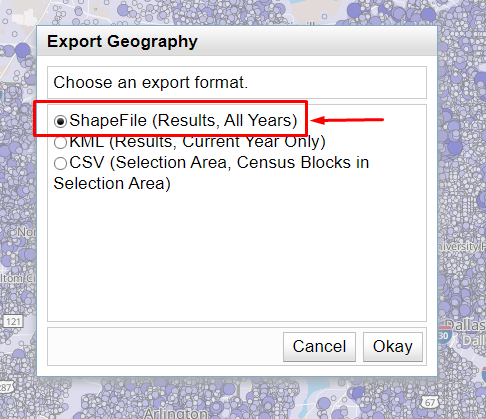

5. Download Files

- Geography (Shapefile)
- File Specifications (Guide File)

  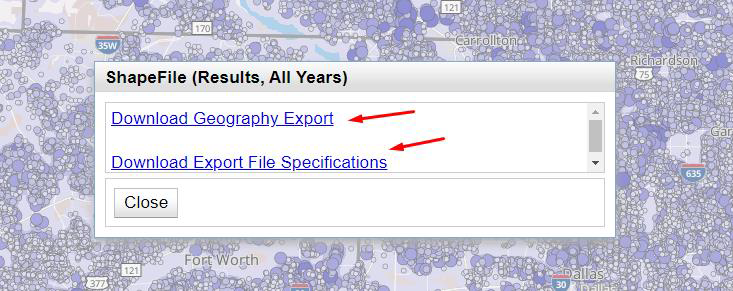


6. Unzip `LEHD` OTM files

   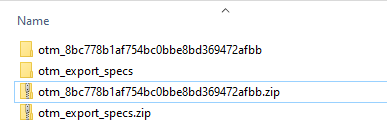

7. Review File Specifications (Guide File)

   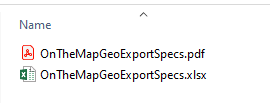
   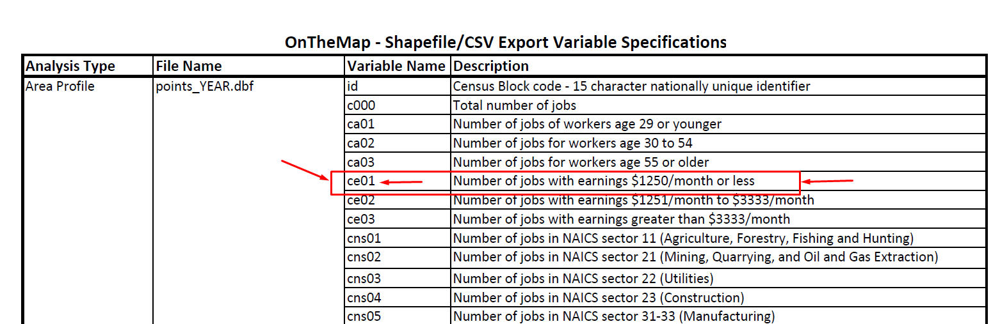
   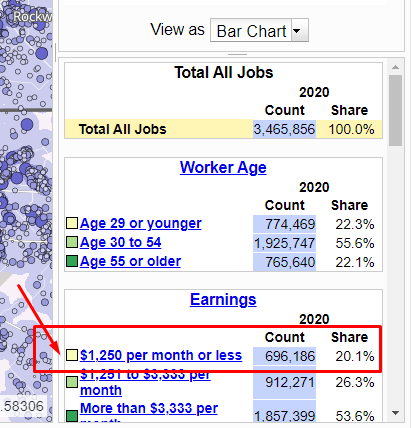

8. Review `LEHD` Shapefiles

   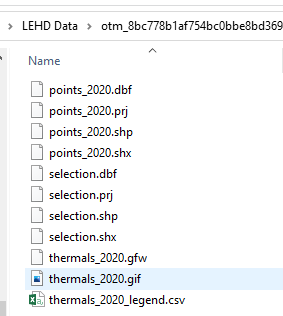

9. Add GIS `LEHD` Shapefiles in ArcGIS

   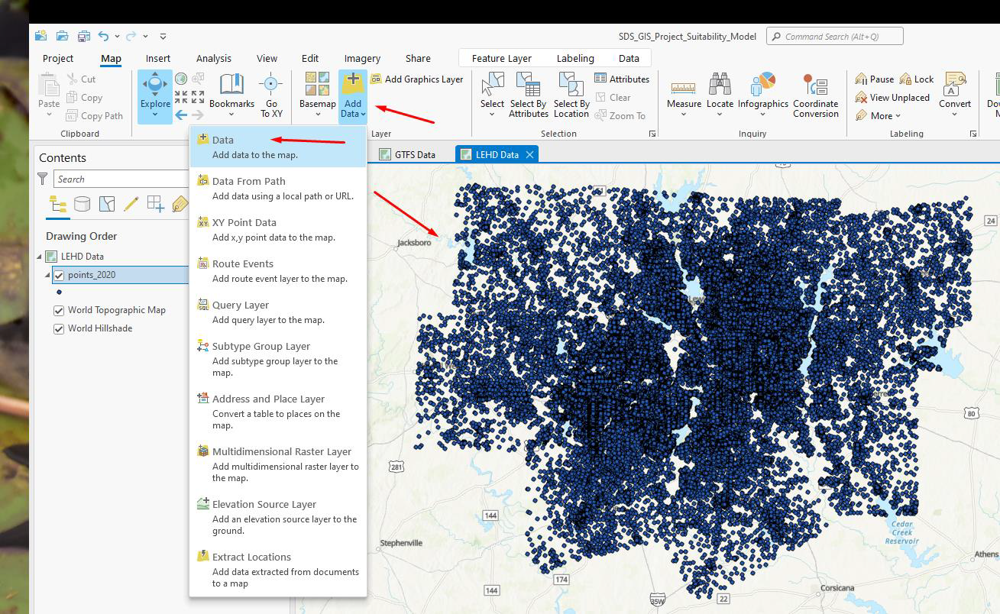

10. Review `LEHD` Attribute Table

    - `Id`: column represents census block IDs
    - `Ce01`: Number of low-wage job workers.

    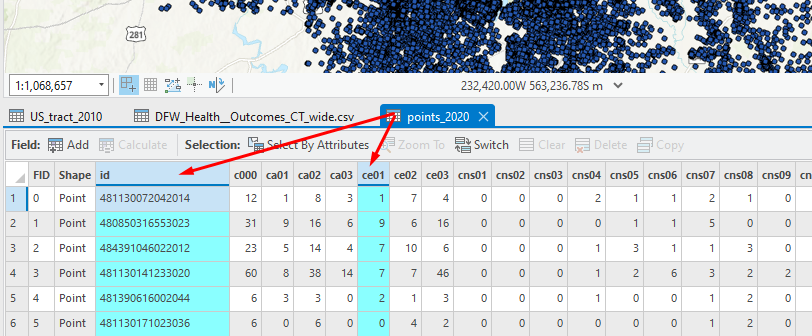

11. Remove unrelated fields and keep only

    - Id, c000, ce01, ce02, ce03

    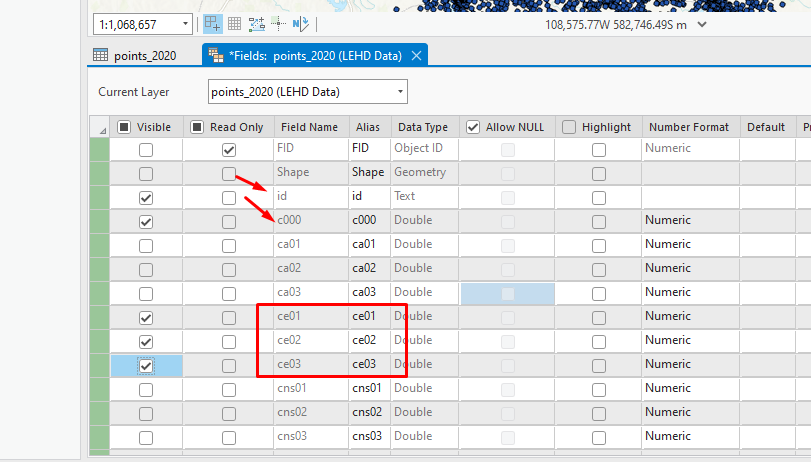
    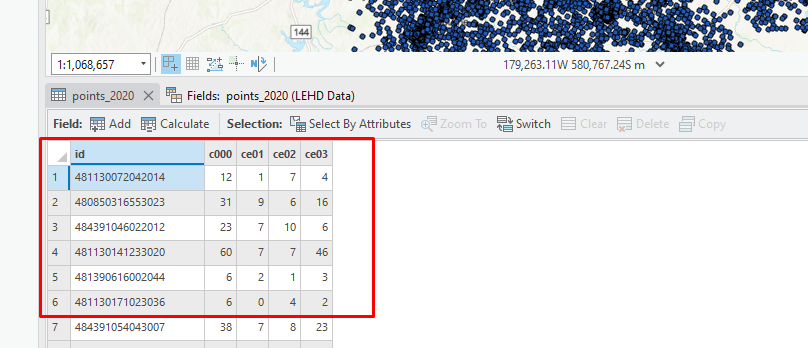

12. Export `LEHD` data to the geodatabase file

    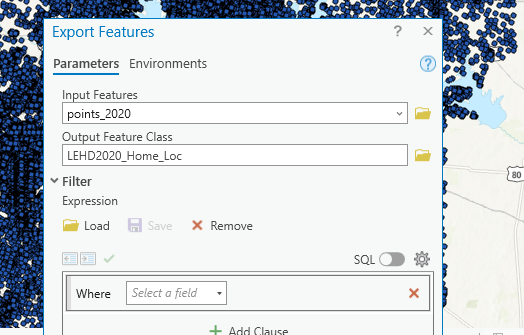


## 3.5. <a id='toc3_5_'></a>[Get Hospital GIS Data](#toc0_)


1. Get Hospitals GIS layer from ArcGIS Hub: [Link](https://hub.arcgis.com/datasets/geoplatform::hospitals/explore?layer=0&location=37.164077%2C-93.154324%2C4.87)

   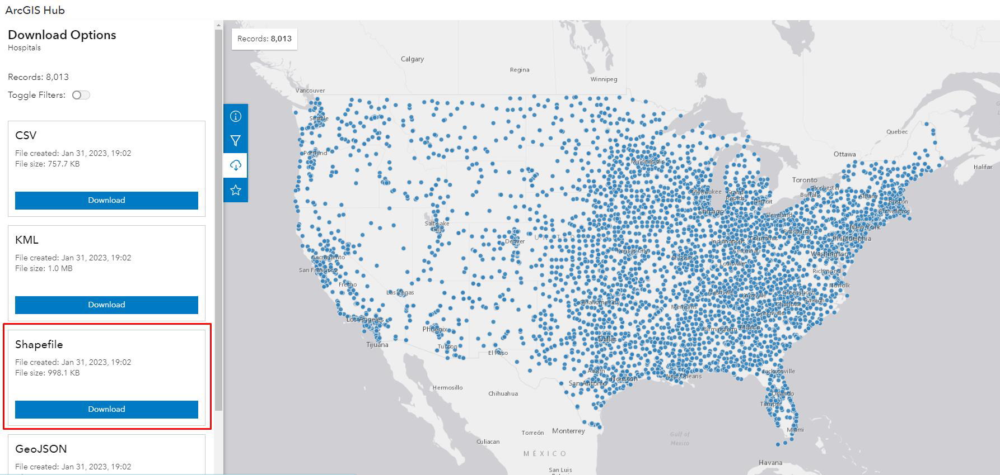

2. Add Hospitals GIS Data

   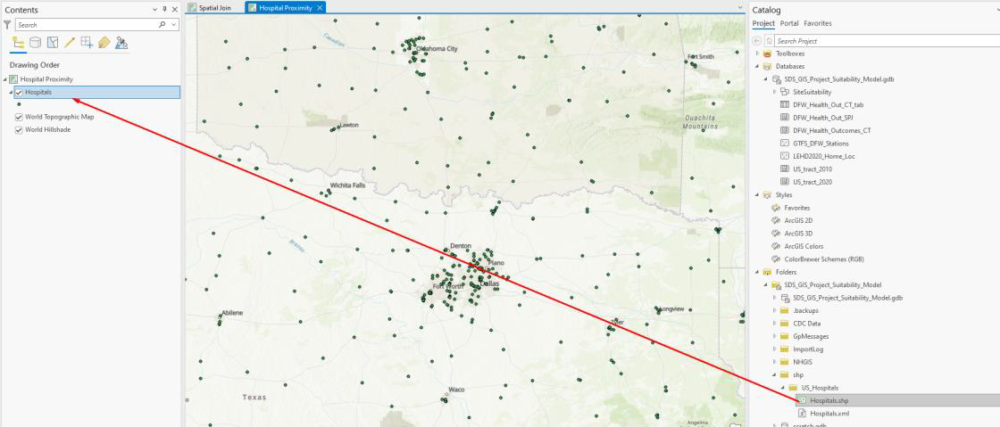

3. Select Hospitals in DFW

   - Use `Select by Attribute` and select hospitals in `Collin`, `Dallas`, `Denton`, and `Tarrant` County.
   - SQL Code: `COUNTYFIPS = '48085' And COUNTYFIPS = '48113' And COUNTYFIPS = '48121' And COUNTYFIPS = '48439'`

   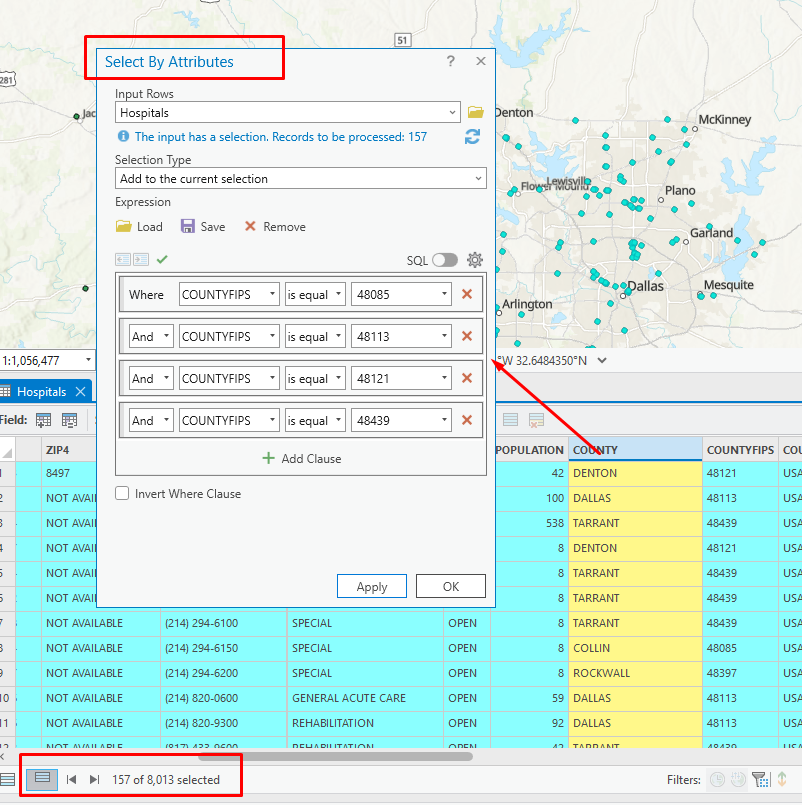

4. Export the selected hospital in DFW
5. Verify and remove extra Hospitals outside the study area, Delete records using `Delete Selection`.

   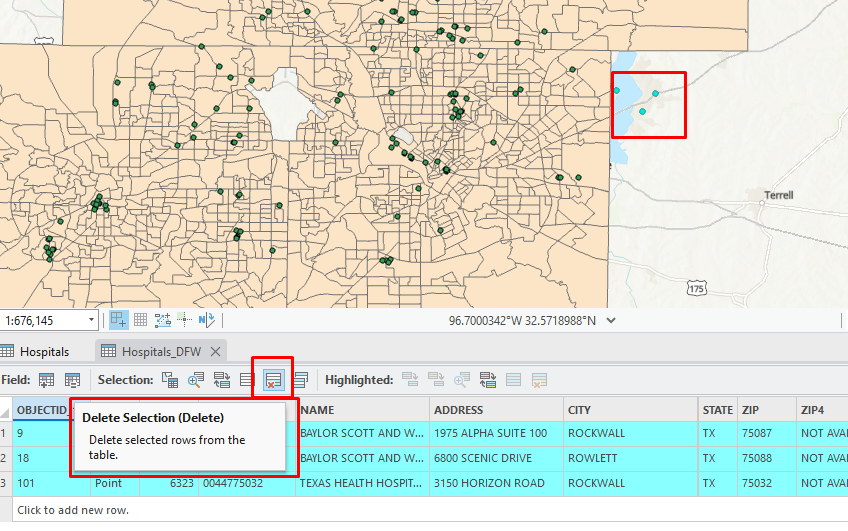

6. Verify the number of Hospitals in DFW: 154 Hospitals

   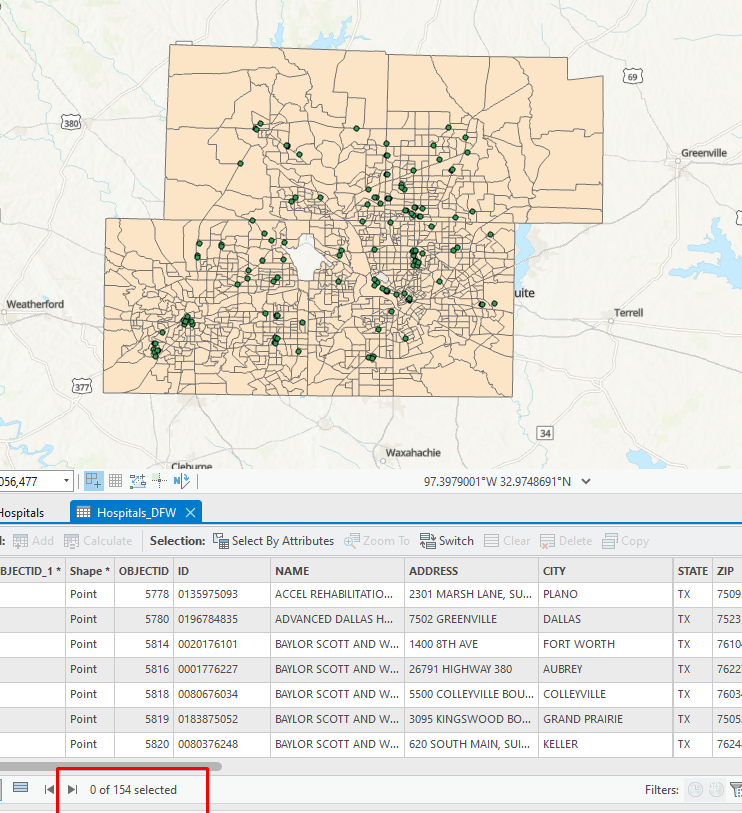


# 4. <a id='toc4_'></a>[Network Analysis](#toc0_)

## 4.1. <a id='toc4_1_'></a>[Service Area Buffers using Network Analysis](#toc0_)


1. Create `3-mile driving buffers` from hospitals using Network Analyst.

   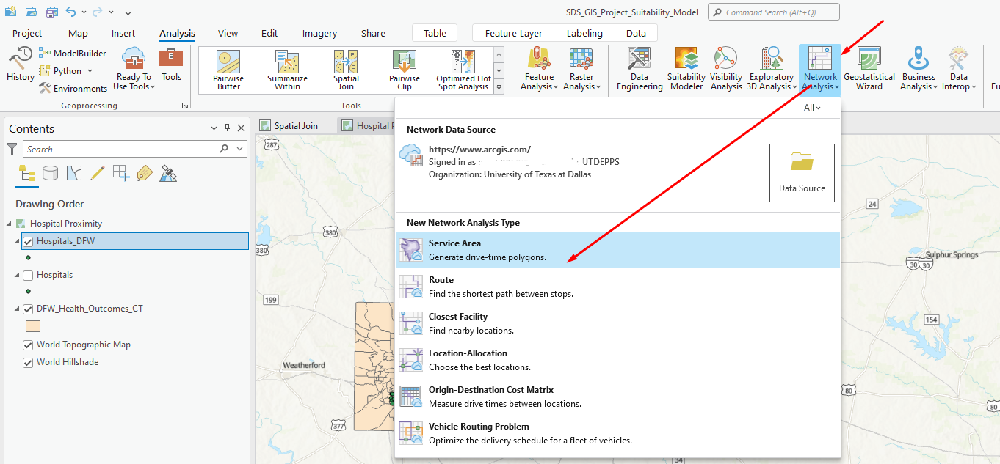

2. Check the Service Area Feature Dataset, Rename the Feature Dataset

   - Feature datasets in ArcGIS Pro
     - A feature dataset is a collection of related feature classes that **share a common coordinate system.**
     - Feature datasets facilitate the creation of controller datasets (sometimes called extension datasets), such as a parcel fabric, topology, or utility network.
     - More info: [Feature datasets in ArcGIS Pro](https://pro.arcgis.com/en/pro-app/3.1/help/data/utility-network/what-is-a-utility-network-.htm)

   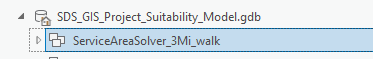

3. Select the `Service Area` layer in the Table of Contents, Select Import `Facilities`

   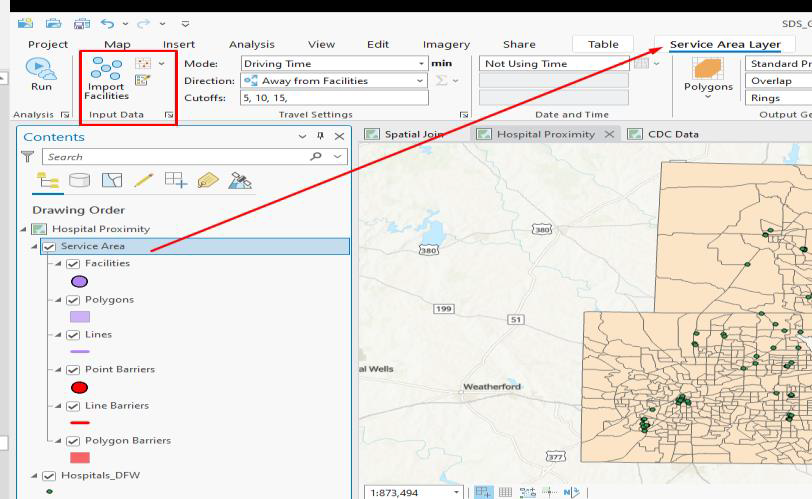

4. Select Import Facilities: Add Locations, and Verify the imported facilities

   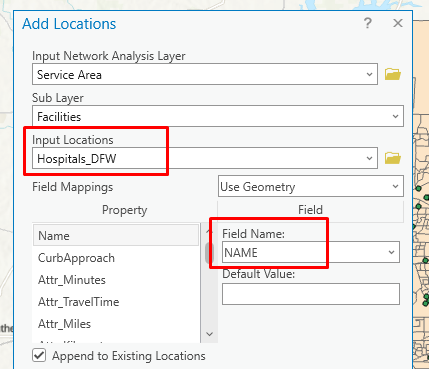
   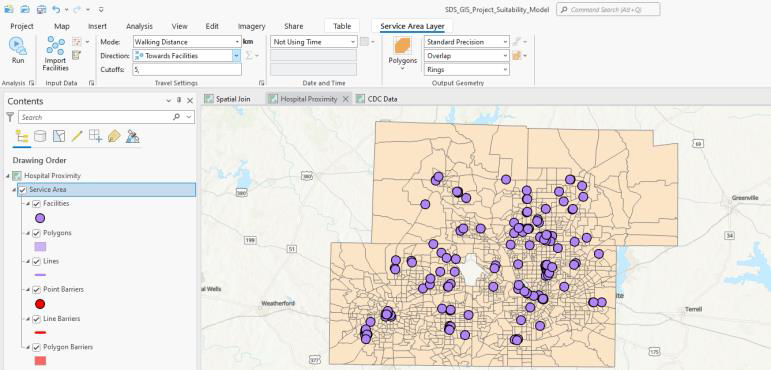

5. Service Area Travel Settings

   1. Select `Service Area` Layer
   2. Choose Layer Properties
   3. Change units from `Kilometers` to `Miles`

   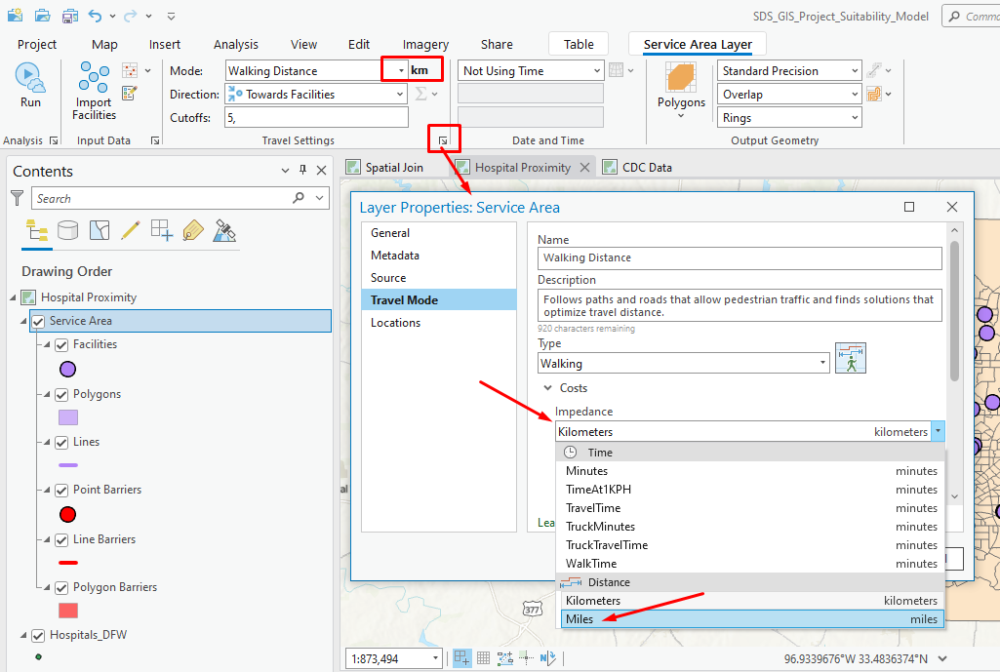

6. Define Service Area Parameters, and run

   - Mode: Walking Distance
   - Direction: Towards Facilities
   - Cutoffs: 3
   - Output Geometry: Standard, Overlap, Rings

   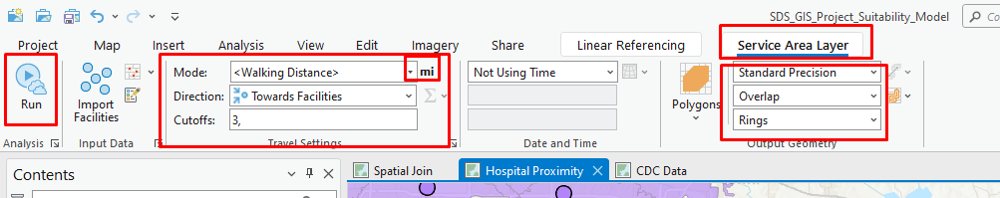
   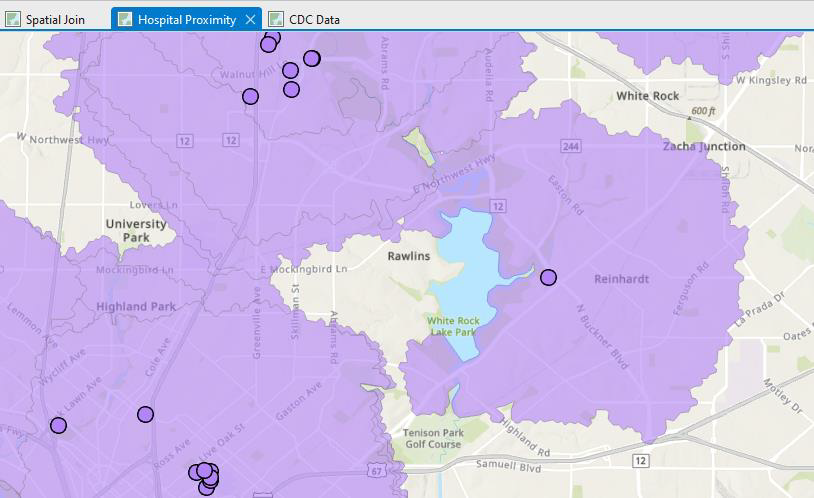


7. Create a copy and Export the `Polygon` layer and Add Model Inputs in Table of Contents

   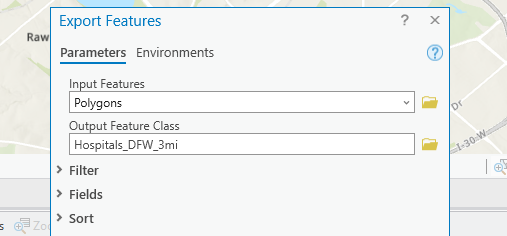
   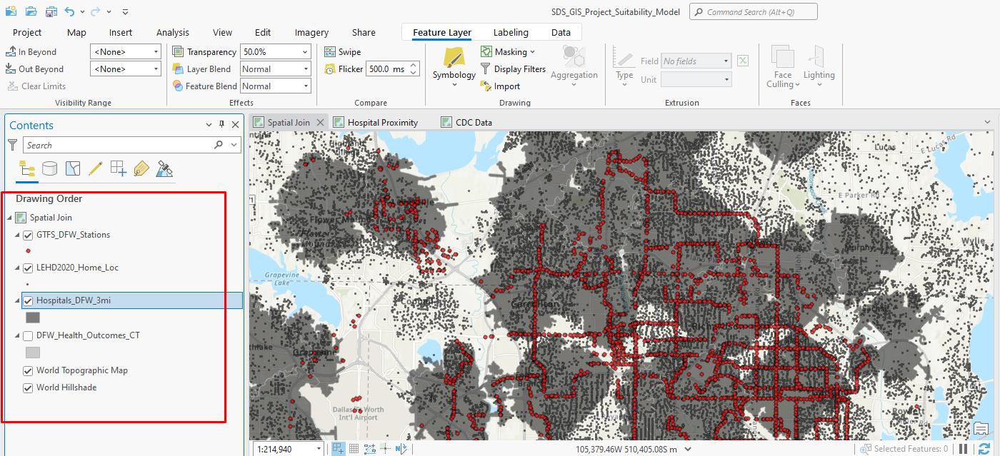


## 4.2. <a id='toc4_2_'></a>[Spatial Join Analysis](#toc0_)

The `Spatial Join` tool joins attributes from one feature to another based on the spatial relationship.

- The target features and the joined attributes from the join features are written to the output feature class.
- A spatial join matches rows from the Join Features values to the Target Features values based on their relative spatial locations.

In this exercise, the `Hospital_DFW_3mi` buffer is the target layer.

- All other GIS layers will be joined to the target layer. The `Spatial Join` tool will be used to join the following layers to the target layer:

1. CDC Health Data
   - Match Option: INTERSECT -- Merge Rule: MEAN
2. GTFS Transit Stations
   - Match Option: INTERSECT -- Merge Rule: COUNT
3. LEHD Low Wage Workers
   - Match Option: INTERSECT -- Merge Rule: SUM


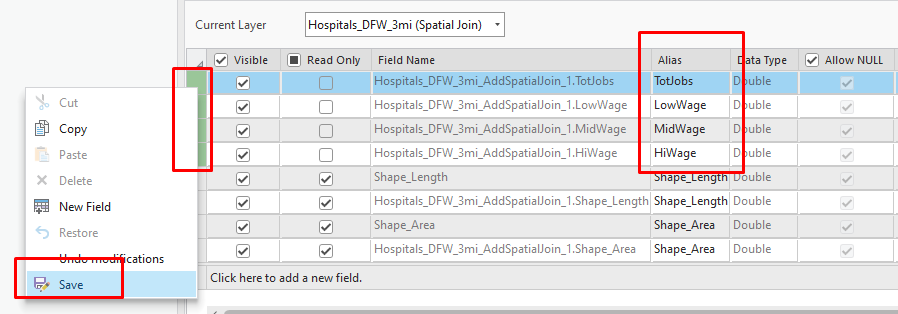


## 4.3. <a id='toc4_3_'></a>[Create a Choropleth map to verify spatial joins](#toc0_)


1. Change Symbology and Use `Graduate Colors` to present the results of Spatial Joins
   1. Example: Service areas by number of transit stations

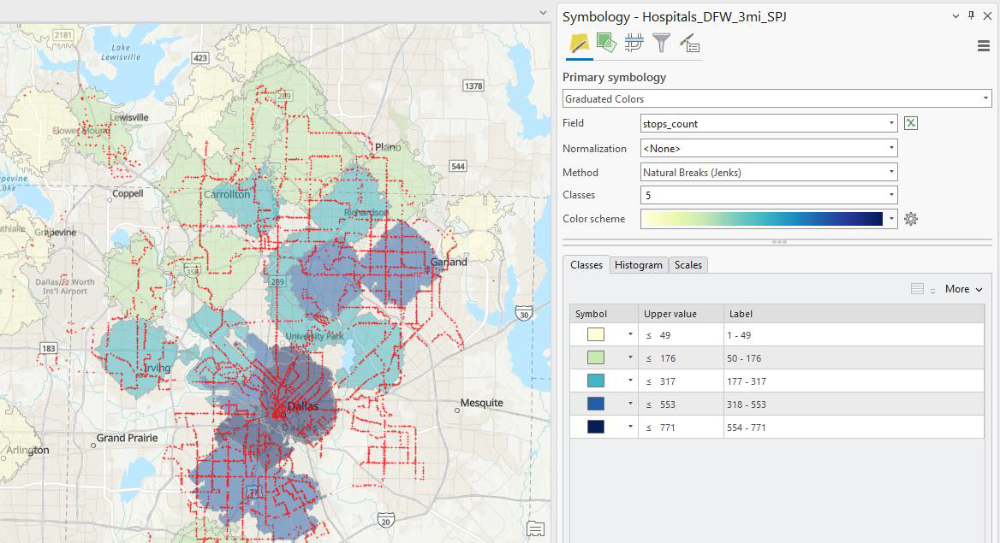


## 4.4. <a id='toc4_4_'></a>[Suitability Analysis using Business Analysis](#toc0_)

Once the `Spatial Join` layer results are ready, we can use the `Suitability Analysis` tool to run the suitability model.


1. Add the `Hospitals_DFW_3mi_SPJ` layer to the Table of Contents

   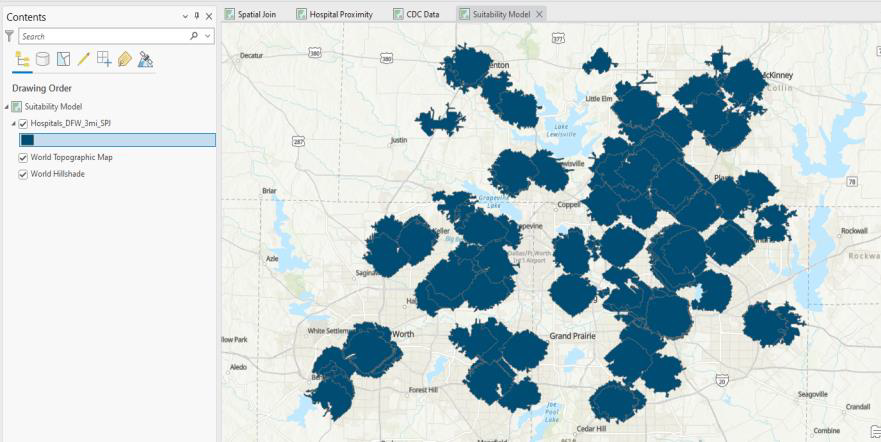

2. From the `Analysis` tab $\to$ Choose `Business Analysis` $\to$ `Suitability Analysis`

   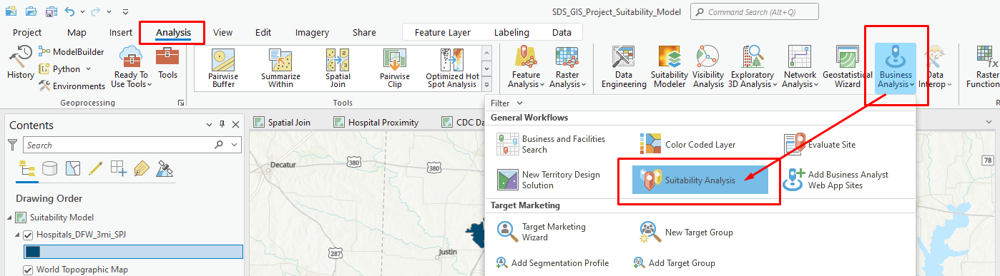

3. Make Suitability Analysis Layer

   - `From Make Suitability Analysis Layer`:
   - Input: `Hospitals_DFW_3mi_SPJ`
   - Layer Name: `Suitability Analysis`

   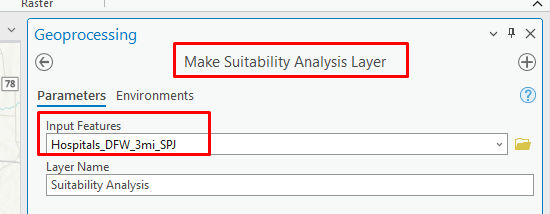

4. Add Criteria to the suitability layer
   Once the `Suitability Analysis` layer is available:

   - Select/Activate it on `Table of Contents`
   - Choose `+Add Criteria`

   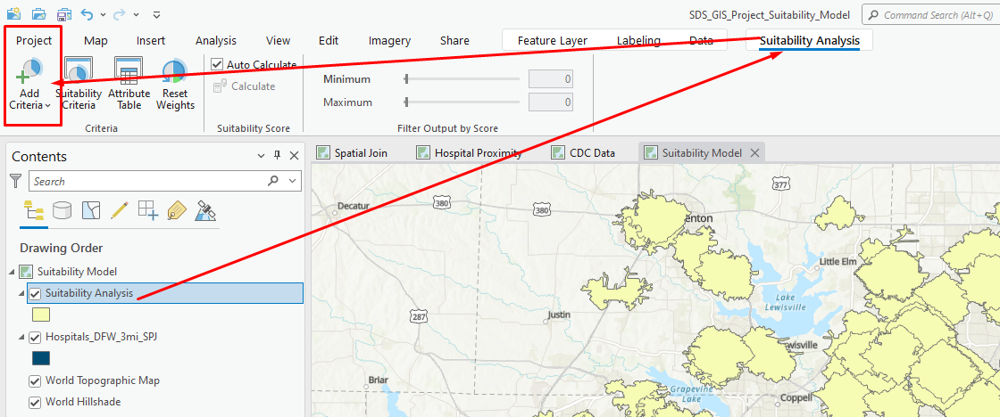

5. Select `Add Fields from Input Layer`

   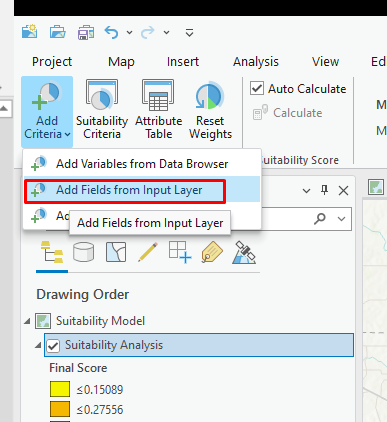

6. Add Field Based Suitability Criteria

   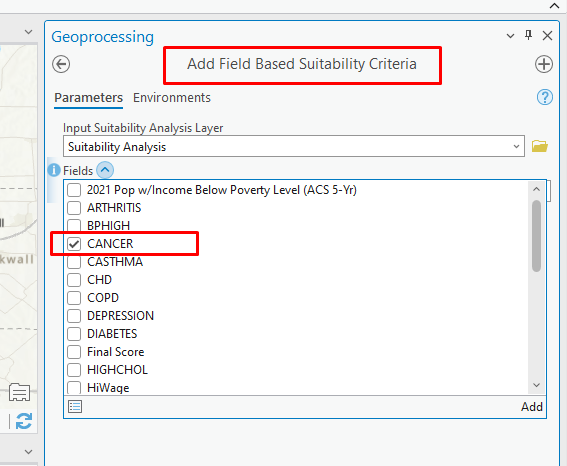


### 4.4.1. <a id='toc4_4_1_'></a>[Add Fields from ArcGIS Online Data Browser](#toc0_)


In addition to the data set from Spatial Joins, you can add other variables from ArcGIS Online Data Browser.

1. Select `Add Variables from Data Browser`

   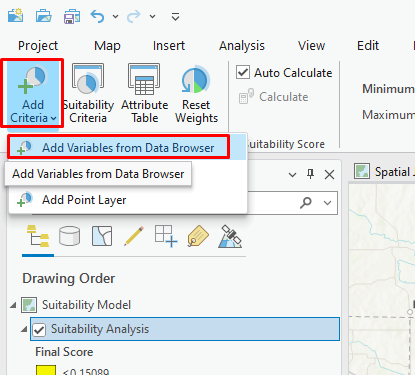

2. Select `+ Add Variables`, Search `Poverty`

   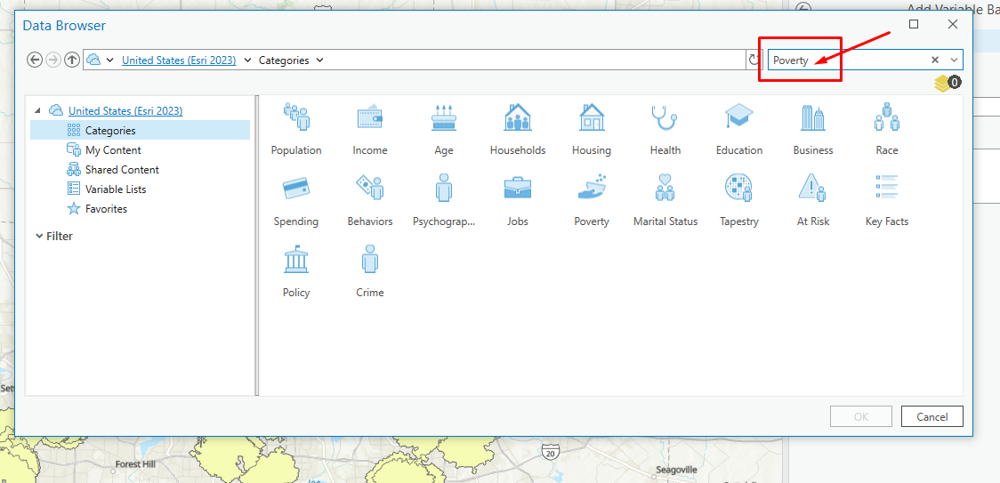

3. Select `Pop w/Income Below Poverty Level (ACS 5-Yr))` -- Number Format (#), and run

   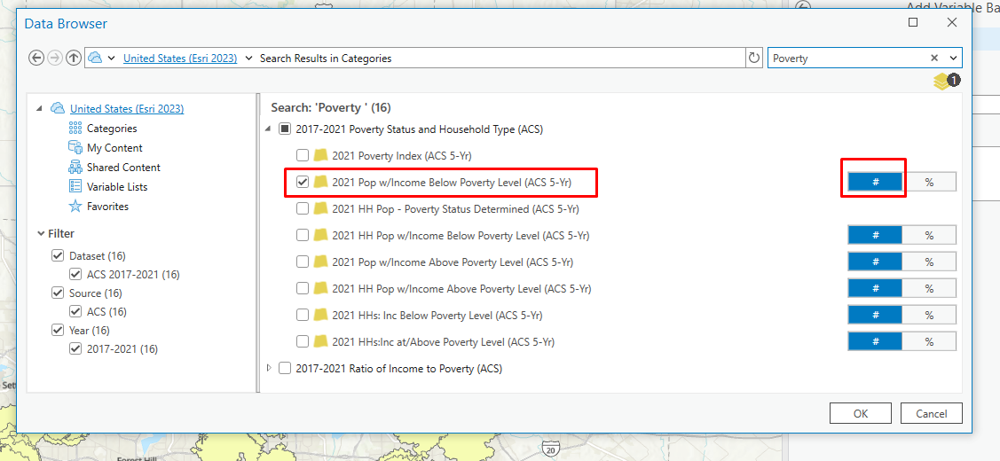


### 4.4.2. <a id='toc4_4_2_'></a>[Apply Weights to Suitability Model](#toc0_)


1. From the `Suitability Analysis` tab, select `Suitability Criteria`, Change Weight in Suitability Analysis

   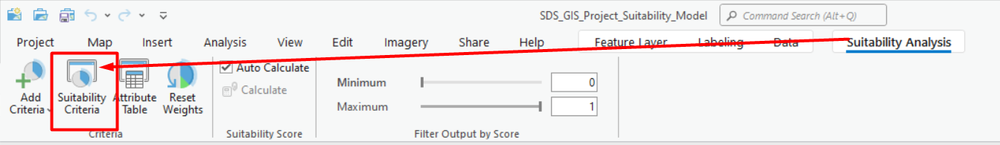
   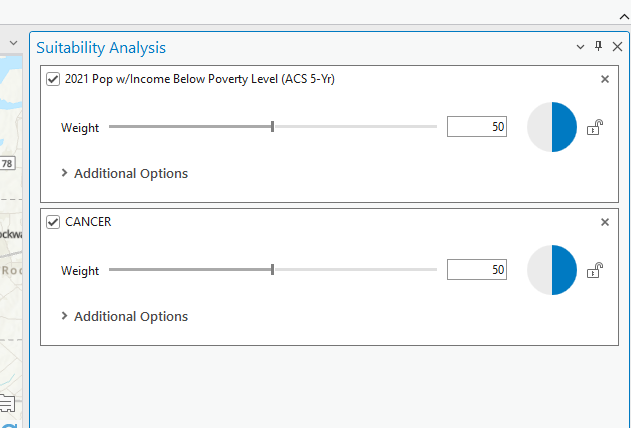

2. Review the results

   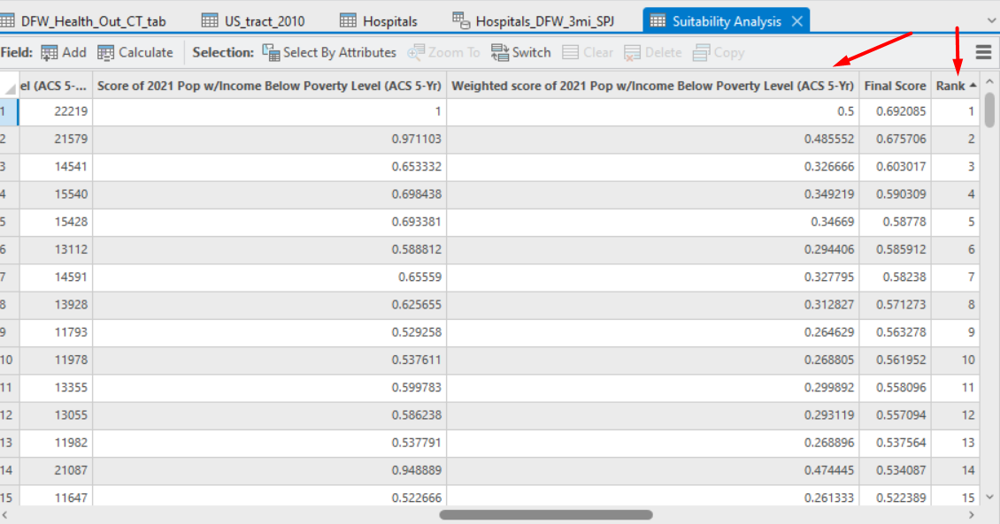

3. Add Additional variables to the suitability model.

   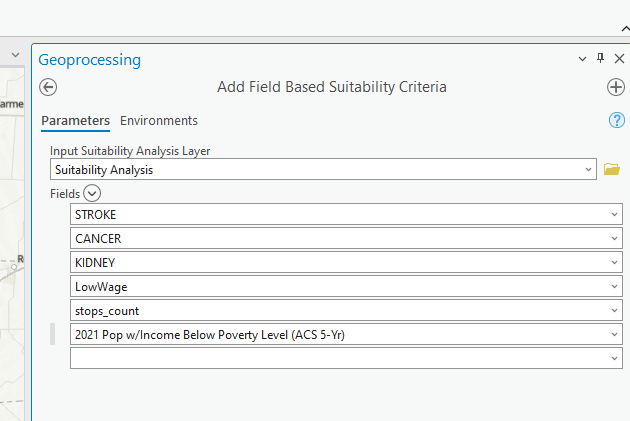

4. Apply weights to the model,Review the results

   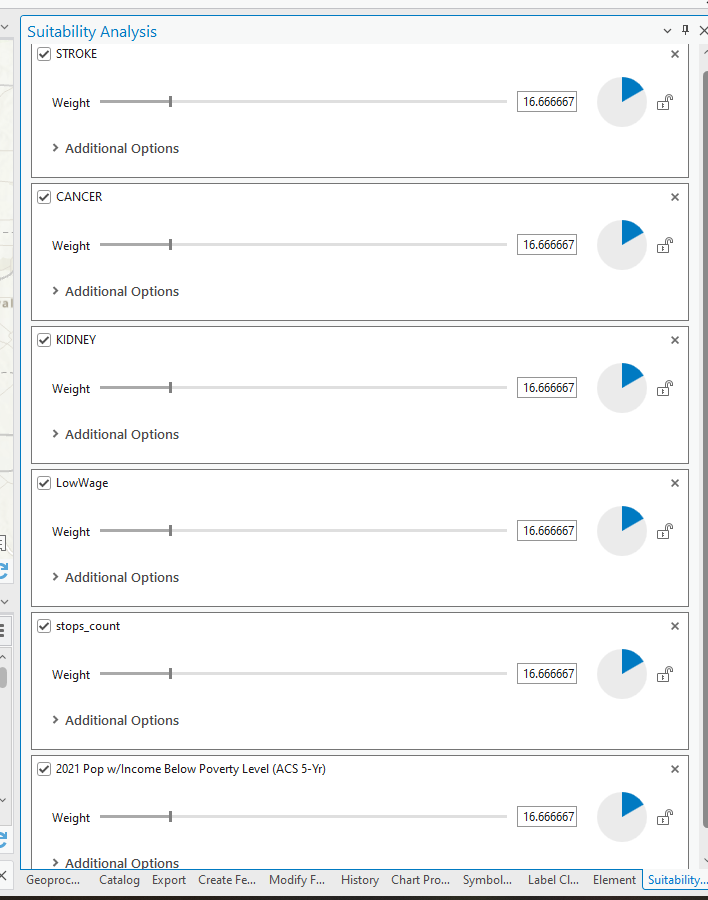
   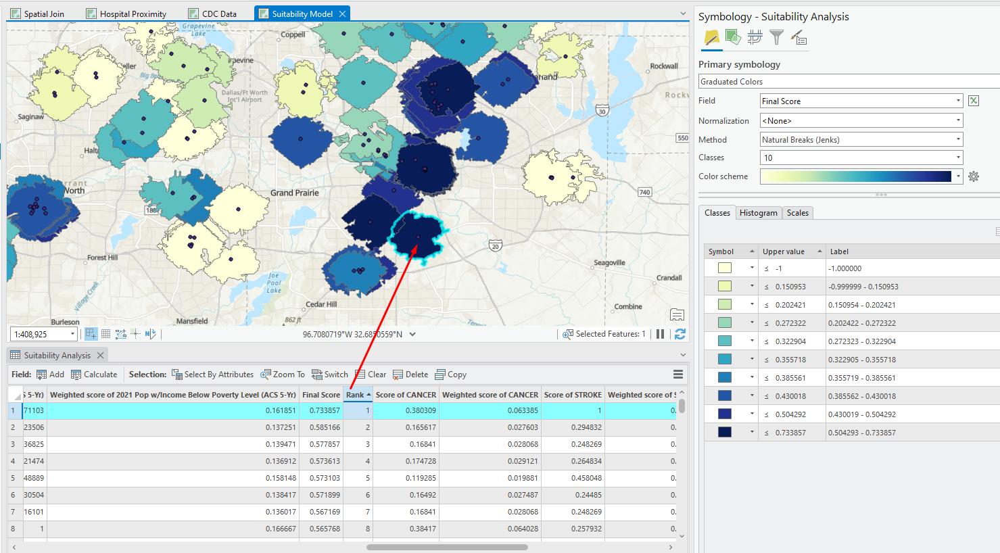


# 5. <a id='toc5_'></a>[Additional Sources](#toc0_)

- [It’s Harder for People Living in Poverty to Get Health Care](https://www.commonwealthfund.org/publications/podcast/2019/apr/its-harder-people-living-poverty-get-health-care)
- [Hospital Charity Care: How It Works and Why It Matters](https://www.kff.org/health-costs/issue-brief/hospital-charity-care-how-it-works-and-why-it-matters/)
- [Suitability Analysis](https://pro.arcgis.com/en/pro-app/latest/help/analysis/business-analyst/understanding-suitability-analysis.htm)
